In [2]:
%matplotlib inline
%reload_ext autoreload
%autoreload 2
%config InlineBackend.figure_format = 'retina'
%reload_ext lab_black

In [3]:
import matplotlib.pyplot as plt
import numpy as np
import xarray as xr
import seaborn as sns
import logging

FORMAT = "%(asctime)s %(message)s"

logging.basicConfig(level="INFO", format=FORMAT, datefmt="%d-%b-%y %H:%M:%S")
sns.set_context("talk")

In [4]:
epoch_key = ("peanut", 14, 4)  # animal, day, epoch

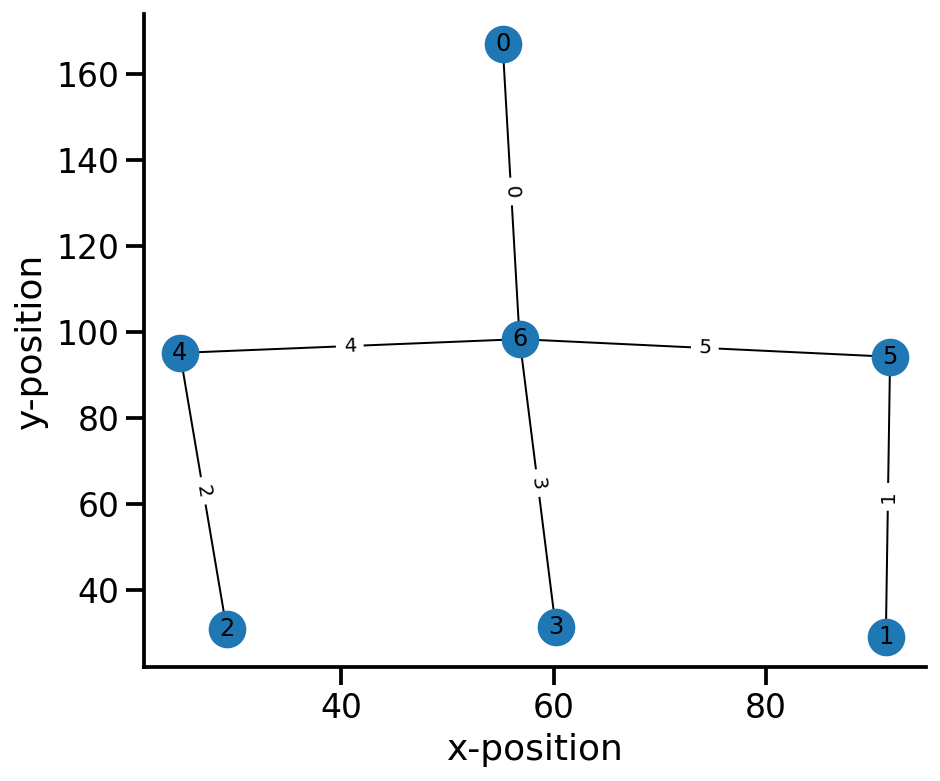

In [5]:
from src.load_data import get_track_graph
from track_linearization import plot_track_graph


track_graph = get_track_graph()

fig, ax = plt.subplots(figsize=(7, 6))
plot_track_graph(track_graph, ax=ax, draw_edge_labels=True)
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)
ax.set_xlabel("x-position")
ax.set_ylabel("y-position")
ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)

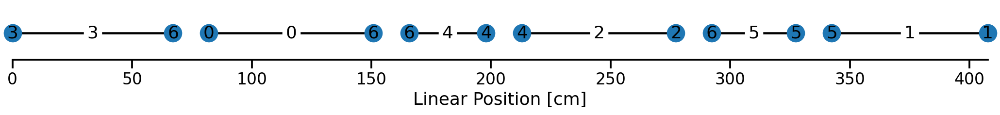

In [6]:
from track_linearization.utils import plot_graph_as_1D
from src.parameters import EDGE_ORDER, EDGE_SPACING

fig, ax = plt.subplots(figsize=(18, 1))
plot_graph_as_1D(
    track_graph,
    edge_spacing=EDGE_SPACING,
    edge_order=EDGE_ORDER,
    ax=ax,
    draw_edge_labels=True,
)

In [42]:
from src.load_data import load_data


data = load_data(epoch_key)

22-Jan-21 10:32:24 Loading position information and linearizing...
22-Jan-21 10:32:27 Loading multiunits...


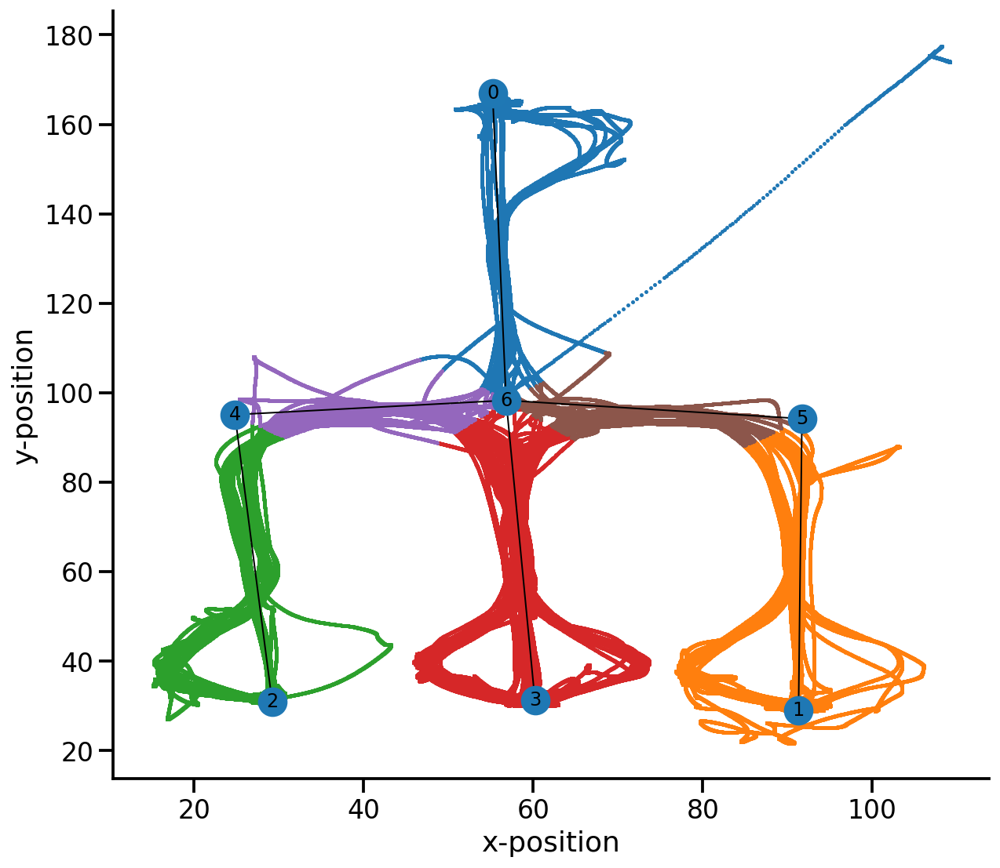

In [43]:
fig, ax = plt.subplots(figsize=(10, 9))
plot_track_graph(data["track_graph"], ax=ax, draw_edge_labels=False)
for name, df in data["position_info"].groupby("track_segment_id"):
    plt.scatter(df.x_position, df.y_position, s=1, label=name, zorder=-1)
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)
ax.set_xlabel("x-position")
ax.set_ylabel("y-position")
ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)

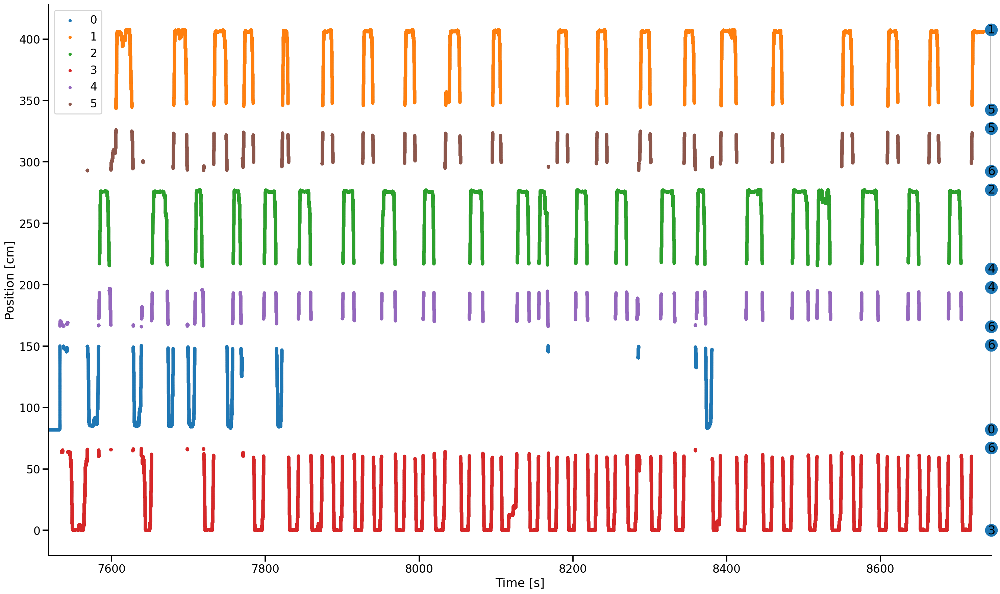

In [44]:
from track_linearization import plot_graph_as_1D
from src.parameters import EDGE_ORDER, EDGE_SPACING

plt.figure(figsize=(25, 15))

time = data["position_info"].index / np.timedelta64(1, "s")
plt.scatter(time, data["position_info"].linear_position, color="lightgrey", s=10)

for name, df in data["position_info"].groupby("track_segment_id"):
    plt.scatter(df.index / np.timedelta64(1, "s"), df.linear_position, s=10, label=name)

plot_graph_as_1D(
    data["track_graph"],
    edge_order=EDGE_ORDER,
    edge_spacing=EDGE_SPACING,
    axis="y",
    other_axis_start=10.0 + time[-1],
)

plt.legend()
plt.ylabel("Position [cm]")
plt.xlabel("Time [s]")
plt.xlim((time[0], time[-1] + 10.0))

sns.despine()

In [47]:
data["tetrode_info"]

area  clockrate deadchans depth    endtime  \
animal day epoch tetrode_number                                              
peanut 14  4     1               CA1    30000.0       NaN    []  8734.2099   
                 2               CA1    30000.0         4    []  8734.2099   
                 3               CA1    30000.0       NaN    []  8734.2099   
                 4               CA1    30000.0       NaN    []  8734.2099   
                 5               CA1    30000.0         4    []  8734.2099   
...                              ...        ...       ...   ...        ...   
                 124             NaN    30000.0       NaN    []  8734.2099   
                 125             NaN    30000.0       NaN    []  8734.2099   
                 126             NaN    30000.0       NaN    []  8734.2099   
                 127             NaN    30000.0       NaN    []  8734.2099   
                 128             NaN    30000.0       NaN    []  8734.2099   

                                 nTrode  nTrodeChannel  numcells   ref  \
animal day epoch tetrode_number                                          
peanut 14  4     1                  1.0            1.0       0.0  13.0   
                 2                  2.0            1.0       0.0  13.0   
                 3                  3.0            1.0       0.0  13.0   
                 4                  4.0            1.0       0.0  13.0   
                 5                  5.0            1.0       0.0  13.0   
...                                 ...            ...       ...   ...   
                 124              124.0            1.0       0.0   NaN   
                 125              125.0            1.0       0.0   NaN   
                 126              126.0            1.0       0.0   NaN   
                 127              127.0            1.0       0.0   NaN   
                 128              128.0            1.0       0.0   NaN   

                                refNTrode  samprate    starttime suparea  \
animal day epoch tetrode_number                                            
peanut 14  4     1                     []    1500.0  7518.437233     HPc   
                 2                     []    1500.0  7518.437233     HPc   
                 3                     []    1500.0  7518.437233     HPc   
                 4                     []    1500.0  7518.437233     HPc   
                 5                     []    1500.0  7518.437233     HPc   
...                                   ...       ...          ...     ...   
                 124                   []    1500.0  7518.437233     NaN   
                 125                   []    1500.0  7518.437233     NaN   
                 126                   []    1500.0  7518.437233     NaN   
                 127                   []    1500.0  7518.437233     NaN   
                 128                   []    1500.0  7518.437233     NaN   

                                       tetrode_id  
animal day epoch tetrode_number                    
peanut 14  4     1               peanut_14_04_001  
                 2               peanut_14_04_002  
                 3               peanut_14_04_003  
                 4               peanut_14_04_004  
                 5               peanut_14_04_005  
...                                           ...  
                 124             peanut_14_04_124  
                 125             peanut_14_04_125  
                 126             peanut_14_04_126  
                 127             peanut_14_04_127  
                 128             peanut_14_04_128  

[128 rows x 14 columns]

In [31]:
# from loren_frank_data_processing import make_neuron_dataframe

# neuron_info = make_neuron_dataframe(ANIMALS).xs(
#     epoch_key, drop_level=False)

In [15]:
from loren_frank_data_processing.multiunit import loadmat, get_data_filename


animals = ANIMALS.copy()
is_not_empty = []

for i in range(1, 25):
    tetrode_key = ("peanut", 14, 4, i)
    animal, day, epoch, tetrode_number = tetrode_key
    multiunit_file = loadmat(get_data_filename(animals[animal], day, "marks"))
    multiunit_data = multiunit_file["marks"][0, -1][0, epoch - 1][0, tetrode_number - 1]
    is_not_empty.append(multiunit_data.shape[1])

data["tetrode_info"].iloc[:24].iloc[~np.asarray(is_not_empty, dtype=bool)]

area  clockrate     deadchans depth  \
animal day epoch tetrode_number                                       
peanut 14  4     9               CA1    30000.0             1    []   
                 13              CA1    30000.0           NaN    []   
                 16              CA1    30000.0           NaN    []   
                 21              CA1    30000.0  [1, 2, 3, 4]    []   

                                   endtime  nTrode  nTrodeChannel  numcells  \
animal day epoch tetrode_number                                               
peanut 14  4     9               8734.2099     9.0            1.0       0.0   
                 13              8734.2099    13.0            1.0       0.0   
                 16              8734.2099    16.0            1.0       0.0   
                 21              8734.2099    21.0            1.0       0.0   

                                  ref refNTrode  samprate    starttime  \
animal day epoch tetrode_number                                          
peanut 14  4     9               13.0        []    1500.0  7518.437233   
                 13              13.0        []    1500.0  7518.437233   
                 16              13.0        []    1500.0  7518.437233   
                 21              13.0        []    1500.0  7518.437233   

                                suparea        tetrode_id  
animal day epoch tetrode_number                            
peanut 14  4     9                  HPc  peanut_14_04_009  
                 13                 HPc  peanut_14_04_013  
                 16                 HPc  peanut_14_04_016  
                 21                 HPc  peanut_14_04_021

In [35]:
continuous_transition_types = [["random_walk", "uniform"], ["uniform", "uniform"]]


classifier_parameters = {
    "movement_var": 6.0,
    "replay_speed": 1,
    "place_bin_size": 2.5,
    "continuous_transition_types": continuous_transition_types,
    "discrete_transition_diag": 0.968,
    "model_kwargs": {"bandwidth": np.array([20.0, 20.0, 20.0, 20.0, 8.0])},
}

In [ ]:
from replay_trajectory_classification import ClusterlessClassifier
from sklearn.model_selection import KFold

state_names = ['Continuous', 'Fragmented']
cv = KFold()
results = []

for fold_ind, (train, test) in enumerate(cv.split(data["position_info"].index)):
    logging.info(f'Fitting Fold #{fold_ind + 1}...')
    classifier = ClusterlessClassifier(**classifier_parameters)
    classifier.fit(
        position=data["position_info"].iloc[train].linear_position,
        multiunits=data["multiunits"].isel(time=train),
        track_graph=data["track_graph"],
        edge_order=EDGE_ORDER,
        edge_spacing=EDGE_SPACING,
    )

    logging.info('Predicting posterior...')
    results.append(
        classifier.predict(
            data["multiunits"].isel(time=test),
            time=data["position_info"].iloc[test].index / np.timedelta64(1, "s"),
            state_names=state_names
        )
    )
    
# concatenate cv classifier results 
results = xr.concat(results, dim="time")
logging.info('Done...\n\n')

21-Jan-21 10:37:27 Fitting Fold #1...
21-Jan-21 10:37:27 Fitting initial conditions...
21-Jan-21 10:37:28 Fitting state transition...
21-Jan-21 10:37:28 Fitting multiunits...
21-Jan-21 10:37:31 Predicting posterior...


In [ ]:
classifier.save_model(f"{epoch_key[0]}_{epoch_key[1]:02d}_{epoch_key[2]:02d}_model.pkl")

In [ ]:
results.to_netcdf(
    f"{epoch_key[0]}_{epoch_key[1]:02d}_{epoch_key[2]:02d}_results.nc"
)

In [40]:
results

<xarray.Dataset>
Dimensions:            (position: 141, state: 2, time: 607873)
Coordinates:
  * time               (time) float64 7.518e+03 7.518e+03 ... 8.734e+03
  * position           (position) float64 1.242 3.727 6.212 ... 404.0 406.4
  * state              (state) <U10 'Continuous' 'Fragmented'
Data variables:
    likelihood         (time, state, position) float64 0.5852 0.5753 ... 0.9395
    causal_posterior   (time, state, position) float64 0.003732 ... 0.007195
    acausal_posterior  (time, state, position) float64 0.00029 ... 0.007195

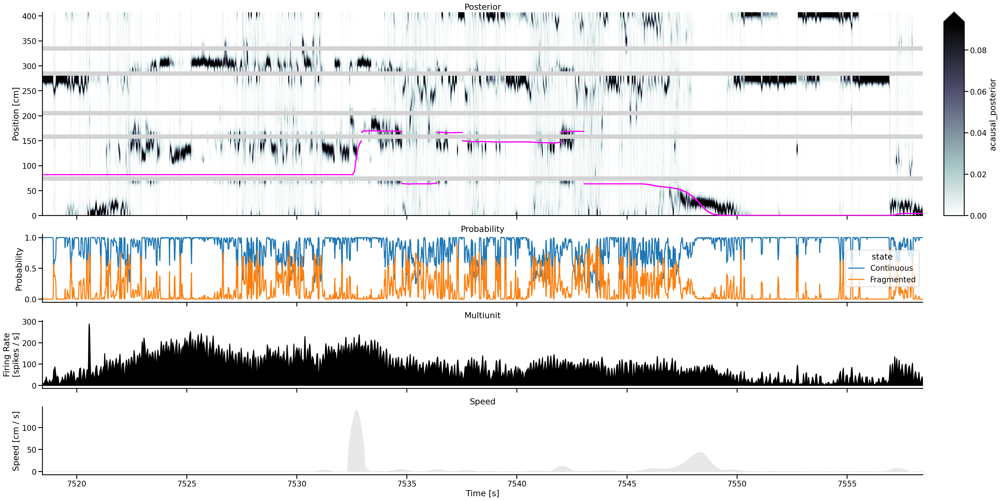

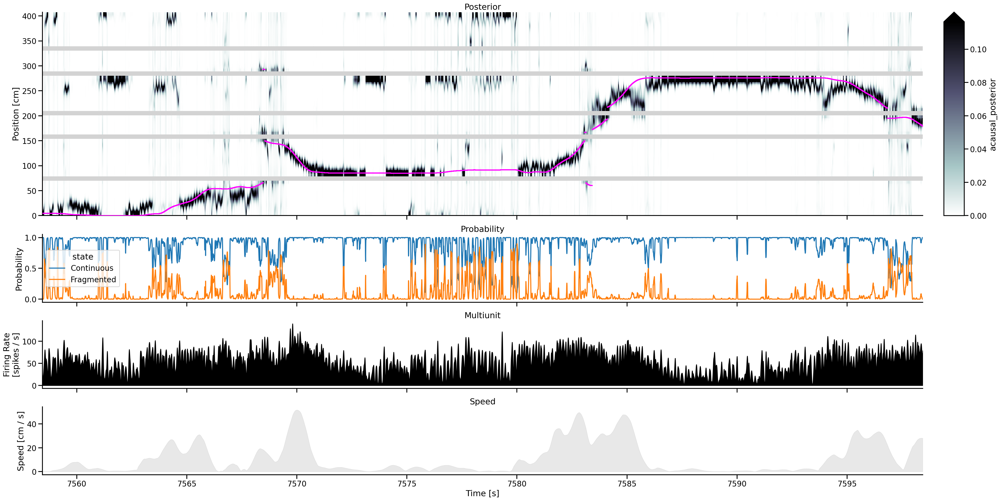

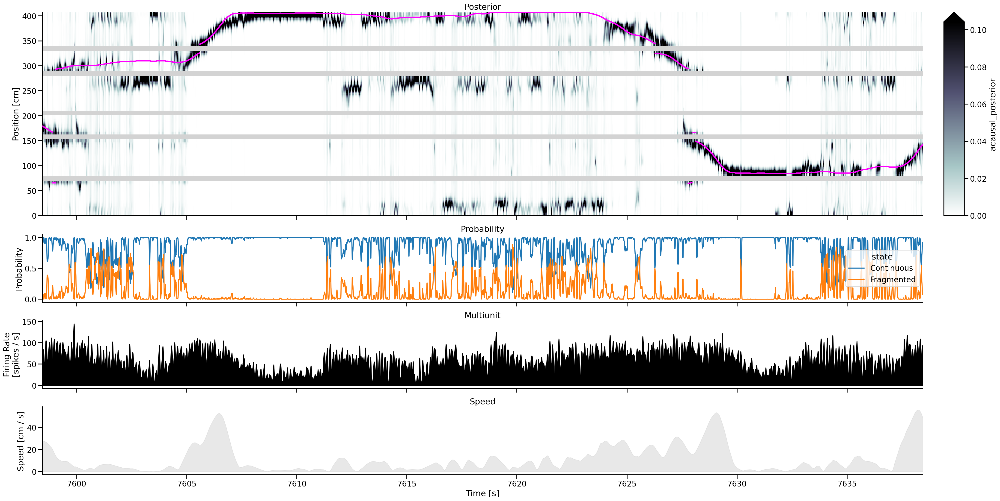

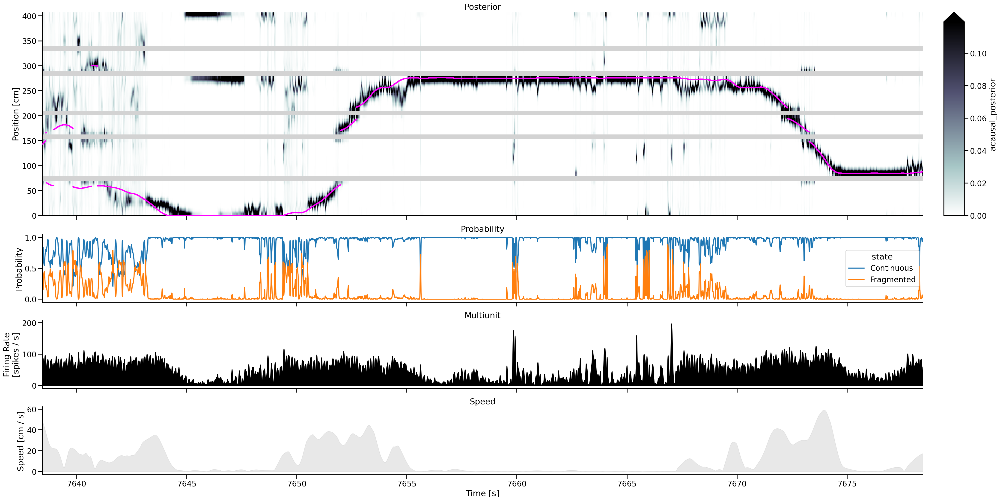

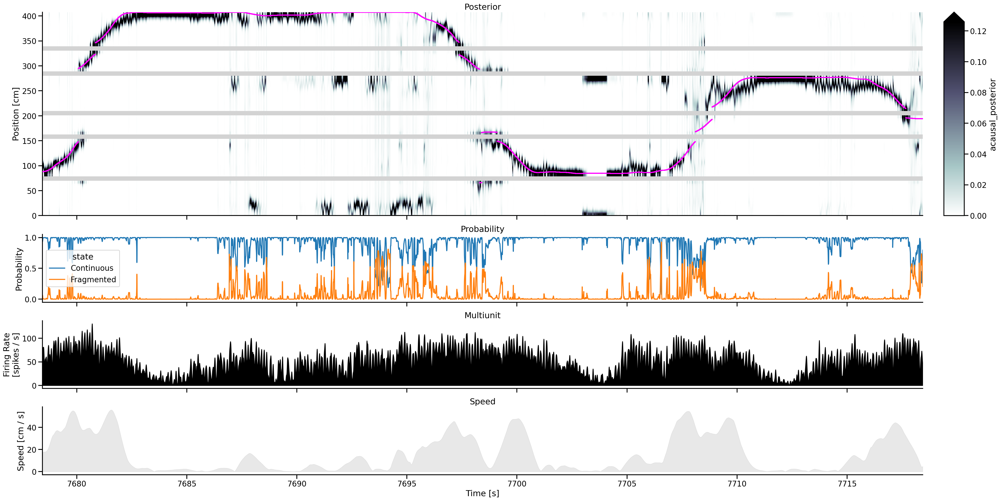

...

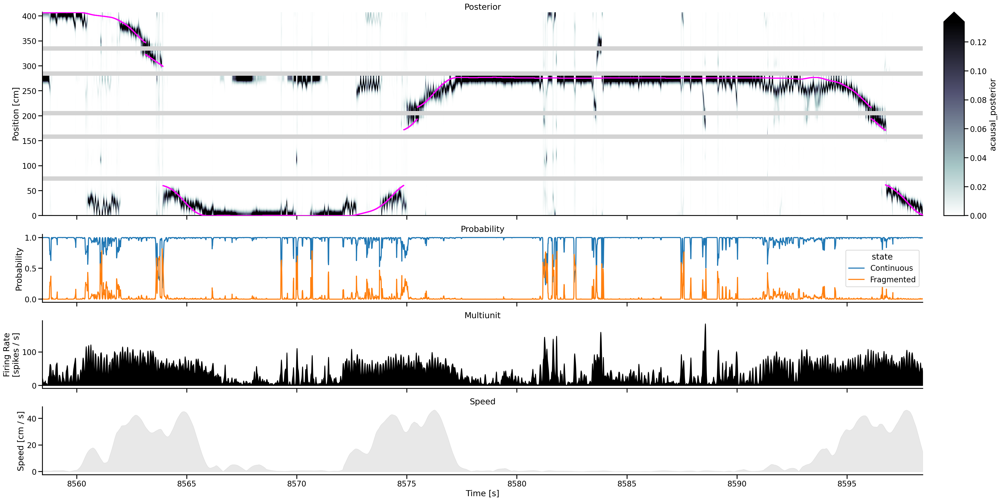

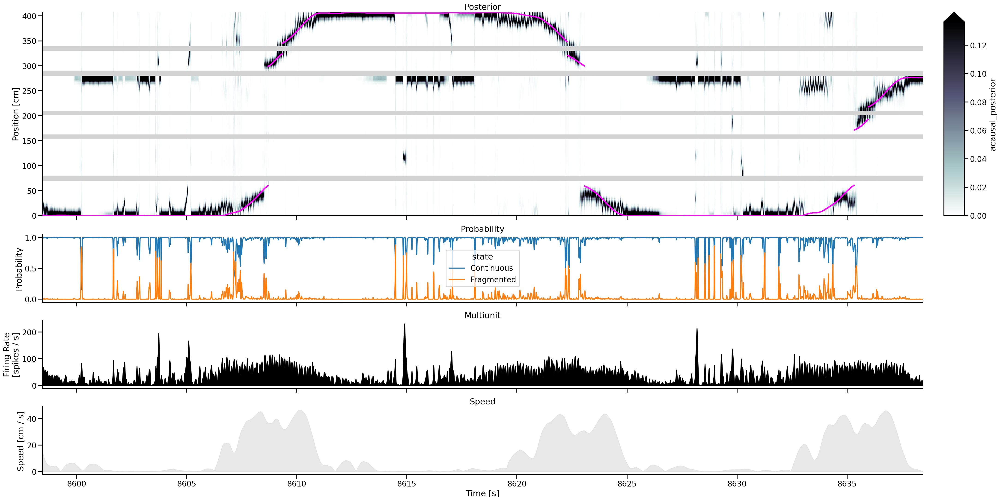

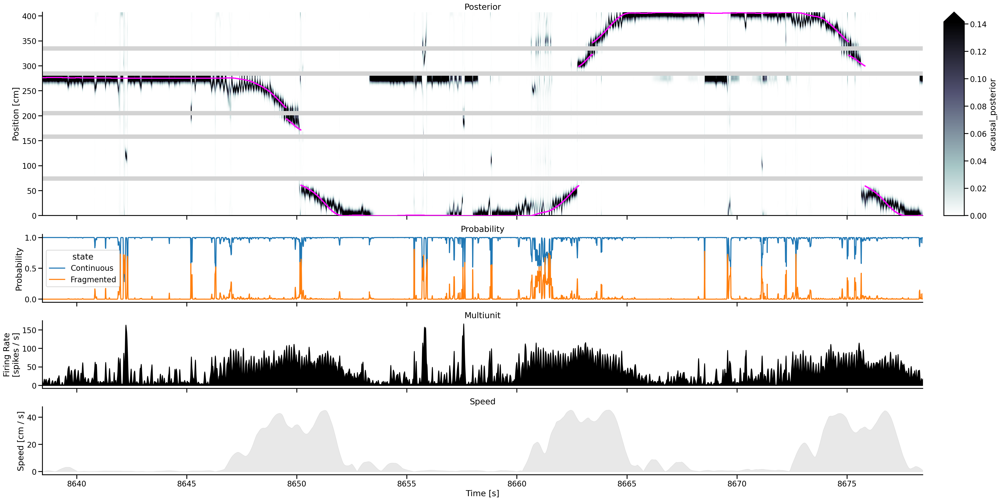

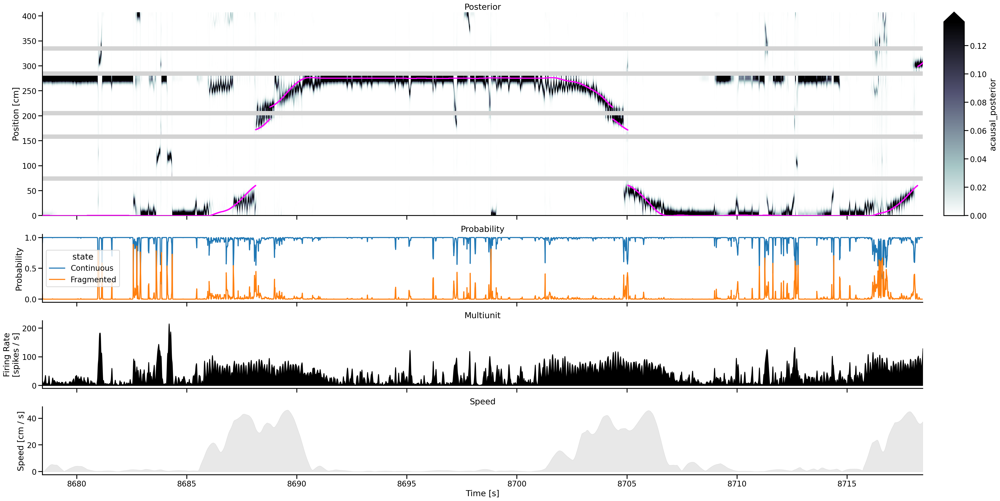

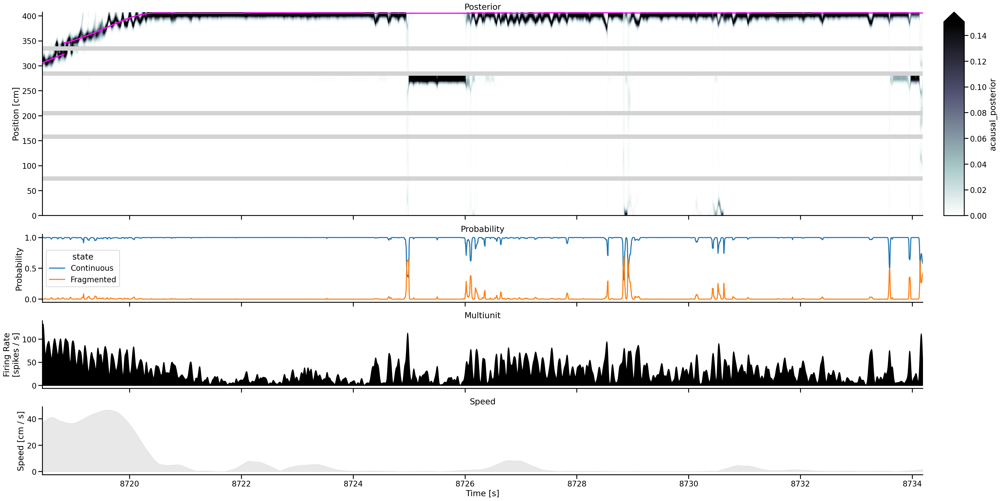

In [61]:
from src.visualization import plot_classifier_time_slice


time = results.time.values

time_ind = np.arange(0, len(time), 20_000)
time_ind = np.append(time_ind, len(time) - 1)

for start_ind, end_ind in zip(time_ind[:-1], time_ind[1:]):
    time_slice = slice(time[start_ind], time[end_ind])

    plot_classifier_time_slice(
        time_slice,
        classifier,
        results,
        data,
        posterior_type="acausal_posterior",
        figsize=(30, 15),
    )